## 1. Import Library & Exploration Dataset from 4 Labels

In [1]:
# Import library-library yang akan dibutuhkan pada eksperimen kali ini
import pandas as pd
import os
from os import listdir, makedirs
from os.path import isfile, join
import matplotlib.pyplot as plt
plt.style.use("ggplot")
import numpy as np
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
import tensorflow as tf
from tensorflow import keras
from PIL import Image
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
import cv2
import random
# import glob
from glob import *
from keras.optimizers import SGD, Adam
from keras.layers import Flatten, BatchNormalization, Dense, Dropout
from tensorflow.keras.models import Sequential
from keras.applications import ResNet152V2
from sklearn.metrics import classification_report, confusion_matrix

In [2]:
# Memanggil semua data gambar dengan keempat kategori yang berbeda yang ada di dalam folder COVID-19_Radiography_Dataset
covid19_images_data = "COVID-19_Radiography_Dataset/COVID"
lung_opacity_images_data = "COVID-19_Radiography_Dataset/Lung_Opacity"
normal_images_data = "COVID-19_Radiography_Dataset/Normal"
pneumonia_images_data = "COVID-19_Radiography_Dataset/Viral Pneumonia"

In [3]:
"""
Memanggil semua gambar dengan seluruh eksistensi gambar (.png/.jpg/.jpeg) yang ada
di dalam keempat DataFrame yang menampung data-data gambar berdasarkan kategorinya
"""
# Data gambar paru-paru manusia yang terkena virus covid-19
covid19_data = glob(covid19_images_data + "/*")

# Data gambar paru-paru dengan kategori penyakit yaitu lung opacity
lung_opacity_data = glob(lung_opacity_images_data + "/*")

# Data gambar dengan kategori paru-paru normal
normal_data = glob(normal_images_data + "/*")

# Data gambar dengan penyakit paru-paru denga kategori pneumonia
pneumonia_data = glob(pneumonia_images_data + "/*")

Keterangan:

Pada script diatas terdapat code dengan "/*" yang menandakan untuk mencocokan segala jenis eksistensi file yang ada di dalam folder tersebut untuk dipanggil ke dalam code. Sebagai contoh jika kita ingin hanya memanggil file dengan eksistensi .txt maka bisa gunakan script "/*.txt" atau jika ingin memanggil file yang hanya bereksistensi .jpg (karena pada eksperimen kali ini menggunakan data images) maka kita bisa menggunakan script "/*.jpg".

In [4]:
# Melihat jumlah masing-masing data gambar dari keempat kategori paru-paru (normal, covid-19, lung opacity atau pneumonia)
print("Nama Ketiga File dari Gambar Covid-19: ", covid19_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Covid-19: ", len(covid19_data), "\n")

print("Nama Ketiga File dari Gambar Lung Opacity: ", lung_opacity_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity: ", len(lung_opacity_data), "\n")

print("Nama Ketiga File dari Gambar Normal: ", normal_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Normal: ", len(normal_data), "\n")

print("Nama Ketiga File dari Gambar Pneumonia: ", pneumonia_data[0:3])
print("Jumlah Data pada Kategori Gambar Paru-Paru Pneumonia: ", len(pneumonia_data))

Nama Ketiga File dari Gambar Covid-19:  ['COVID-19_Radiography_Dataset/COVID\\COVID-1.png', 'COVID-19_Radiography_Dataset/COVID\\COVID-10.png', 'COVID-19_Radiography_Dataset/COVID\\COVID-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Covid-19:  1797 

Nama Ketiga File dari Gambar Lung Opacity:  ['COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-1.png', 'COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-10.png', 'COVID-19_Radiography_Dataset/Lung_Opacity\\Lung_Opacity-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Lung Opacity:  2000 

Nama Ketiga File dari Gambar Normal:  ['COVID-19_Radiography_Dataset/Normal\\Normal-1.png', 'COVID-19_Radiography_Dataset/Normal\\Normal-10.png', 'COVID-19_Radiography_Dataset/Normal\\Normal-100.png']
Jumlah Data pada Kategori Gambar Paru-Paru Normal:  2000 

Nama Ketiga File dari Gambar Pneumonia:  ['COVID-19_Radiography_Dataset/Viral Pneumonia\\Viral Pneumonia-1.png', 'COVID-19_Radiography_Dataset/Viral Pneumonia\\Viral Pneumoni

In [5]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu Normal dan Pneumonia
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Normal"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------")

# Gambar x-ray dengan urutan file ke-1.798
normal_img1798_resolution = Image.open(str(normal_data[33]))
width, height = normal_img1798_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-1.001
normal_img1001_resolution = Image.open(str(normal_data[22]))
width, height = normal_img1001_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-862
normal_img862_resolution = Image.open(str(normal_data[11]))
width, height = normal_img862_resolution.size

print("Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Pneumonia"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------")

# Gambar x-ray 377
pneumonia_img377_resolution = Image.open(str(pneumonia_data[11]))
width, height = pneumonia_img377_resolution.size

print("Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 784
pneumonia_img784_resolution = Image.open(str(pneumonia_data[22]))
width, height = pneumonia_img784_resolution.size

print("Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

# Gambar x-ray 1.008
pneumonia_img1008_resolution = Image.open(str(pneumonia_data[44]))
width, height = pneumonia_img1008_resolution.size

print("Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Normal--------------------
Dimensi Ukuran Gambar Urutan 1.798 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.001 pada Hasil X-Ray Normal adalah: 299x299
Dimensi Ukuran Gambar Urutan 862 pada Hasil X-Ray Normal adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Pneumonia--------------------
Dimensi Ukuran Gambar Urutan 377 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 784 pada Hasil X-Ray Pneumonia adalah: 299x299
Dimensi Ukuran Gambar Urutan 1.008 pada Hasil X-Ray Pneumonia adalah: 299x299


In [6]:
"""
Mengecek resolusi/dimensi dari beberapa gambar x-ray
dari dua kategori/status kesehatan paru-paru yaitu covid-19 dan Lung Opacity
"""

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Covid-19"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------")

# Gambar x-ray pertama
covid19_img1_resolution = Image.open(str(covid19_data[0]))
width, height = covid19_img1_resolution.size # .size merupakan sebuah function untuk memanggil ukuran pada suatu gambar

print("Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-53
covid19_img53_resolution = Image.open(str(covid19_data[11]))
width, height = covid19_img53_resolution.size

print("Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height))

# Gambar x-ray dengan urutan ke-67
covid19_img67_resolution = Image.open(str(covid19_data[22]))
width, height = covid19_img67_resolution.size

print("Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah:", str(width) + "x" + str(height), "\n")

"""Beberapa List Resolusi/Dimensi Gambar X-Ray Paru-Paru Lung Opacity"""
print("--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------")

# Gambar x-ray kelima
lungopacity_img5_resolution = Image.open(str(lung_opacity_data[33]))
width, height = lungopacity_img5_resolution.size

print("Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 39
lungopacity_img39_resolution = Image.open(str(lung_opacity_data[39]))
width, height = lungopacity_img39_resolution.size

print("Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

# Gambar x-ray 119
lungopacity_img119_resolution = Image.open(str(lung_opacity_data[45]))
width, height = lungopacity_img119_resolution.size

print("Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah:", str(width) + "x" + str(height))

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Covid-19--------------------
Dimensi Ukuran Gambar Urutan 1 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 53 pada Hasil X-Ray Covid-19 adalah: 299x299
Dimensi Ukuran Gambar Urutan 67 pada Hasil X-Ray Covid-19 adalah: 299x299 

--------------------Resolusi/Dimensi dari Gambar X-Ray dengan Kategori Paru-Paru Lung Opacity--------------------
Dimensi Ukuran Gambar Urutan 5 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 39 pada Hasil X-Ray Lung Opacity adalah: 299x299
Dimensi Ukuran Gambar Urutan 119 pada Hasil X-Ray Lung Opacity adalah: 299x299


## 2. Eksplorasi Data Gambar berdasarkan Keempat Kategori dari Paru-Paru

### 2.1. Menampilkan Salah Satu Gambar dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.1.1. Gambar X-Ray Paru-Paru Covid-19

COVID-19_Radiography_Dataset/COVID\COVID-108.png


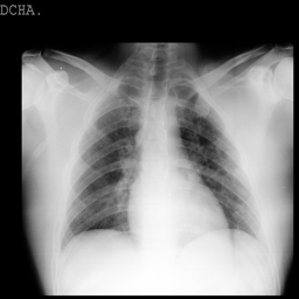

In [7]:
# Menampilkan salah satu gambar random dari paru-paru yang terindikasi terkena virus covid-19
covid_image = list(covid19_data)
print(covid_image[90])

# Membuka gambar dengan indeks array urutan 90 atau dengan kata lain melihat gambar 90 dari paru-paru covid-19
Image.open(str(covid_image[90]))

#### 2.1.2. Gambar X-Ray Paru-Paru Lung Opacity

COVID-19_Radiography_Dataset/Lung_Opacity\Lung_Opacity-1160.png


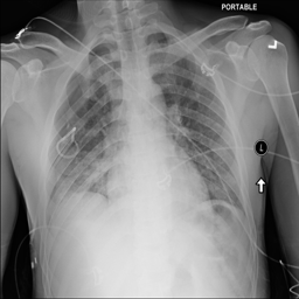

In [8]:
# Menampilkan salah satu gambar random dari paru-paru dari label "Lung_Opacity"
lung_opacity_image = list(lung_opacity_data)
print(lung_opacity_image[180])

"""
Membuka gambar dengan indeks array 180 dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ke-181 dari paru-paru yang terindikasi penyakit dengan kategori lung opacity
"""
Image.open(str(lung_opacity_image[180]))

#### 2.1.3. Gambar X-Ray Paru-Paru Normal

COVID-19_Radiography_Dataset/Normal\Normal-1059.png


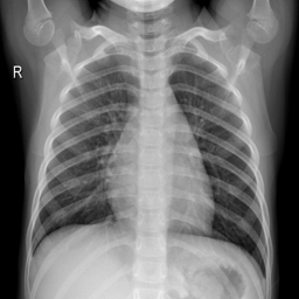

In [9]:
"""
Menampilkan salah satu gambar random dari paru-paru normal
(yang tidak terindikasi penyakit seperti covid-19/lung opacity dan pneumonia)
"""
normal_lung_image = list(normal_data)
print(normal_lung_image[67])

"""
Membuka gambar dengan indeks array 67 dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar dengan urutan ke-68 dari paru-paru yang memliki kategori normal
"""
Image.open(str(normal_lung_image[6]))

#### 2.1.4. Gambar X-Ray Paru-Paru Pneumonia

COVID-19_Radiography_Dataset/Viral Pneumonia\Viral Pneumonia-509.png


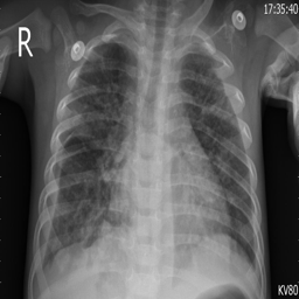

In [10]:
# Menampilkan salah satu gambar dari paru-paru yang terindikasi terkena penyakit pneumonia dari label "Viral Pneumonia"
pneumonia_lung_image = list(pneumonia_data)
print(pneumonia_lung_image[801])

"""
Membuka gambar dengan indeks array 801 dari list gambar yang tersimpan pada local device
atau dengan kata lain melihat gambar ke-802 dari paru-paru yang terindikasi penyakit dengan kategori pneumonia
"""
Image.open(str(pneumonia_lung_image[19]))

### 2.2. Menampilkan Beberapa Gambar dari Keempat Kategori Data X-Ray Images Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia secara Horizontal

#### 2.2.1 Kumpulan Gambar dari Data X-Ray Covid-19

Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: 


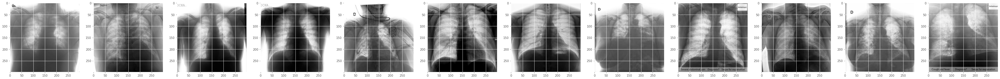

In [11]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi covid-19 dengan cara melakukan perulangan
for covid in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Virus Covid-19: ")
    covid = list(covid19_data)
    covid_path = [k for k in covid19_data]
    
    for i in range (12):
        covid_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(covid_path[i], color_mode="grayscale"))
        axs[i].imshow(covid_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for covid in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru terkena covid. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru covid-19 dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "covid" yang berisikan list dari variabel "covid19_data" memiliki tujuan yaitu variabel "covid" mengambil semua isi data yang ada di dalam variabel "covid19_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "covid_path" terkoneksi atau sangat berkaitan dengan variabel "covid_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.2. Kumpulan Gambar dari Data X-Ray Lung Opacity

Kumpulan Gambar Paru-Paru dari Label Lung_Opacity: 


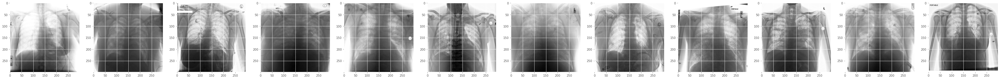

In [12]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi lung opacity dengan cara melakukan perulangan
for lung_opacity in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru dari Label Lung_Opacity: ")
    lungopacity = list(lung_opacity_data)
    lungopacity_path = [k for k in lung_opacity_data]
    
    for i in range (12):
        lung_opacity_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(lungopacity_path[i], color_mode="grayscale"))
        axs[i].imshow(lung_opacity_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for lung_opacity in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru lung opacity. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru lung opacity dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "lungopacity" yang berisikan list dari variabel "lung_opacity_data" memiliki tujuan yaitu variabel "lungopacity" mengambil semua isi data yang ada di dalam variabel "lung_opacity_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "lungopacity_path" terkoneksi atau sangat berkaitan dengan variabel "lung_opacity_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.3. Kumpulan Gambar dari Data X-Ray Normal

Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus Covid-19): 


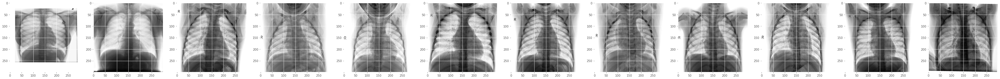

In [13]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang normal (tidak terkena apapun) dengan cara melakukan perulangan
for normal in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Normal (Tanpa Terindikasi/Terkena Virus Covid-19): ")
    normal = list(normal_data)
    normal_path = [k for k in normal_data]
    
    for i in range (12):
        normal_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(normal_path[i], color_mode="grayscale"))
        axs[i].imshow(normal_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for normal in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru normal. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru normal dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "normal" yang berisikan list dari variabel "normal_data" memiliki tujuan yaitu variabel "normal" mengambil semua isi data yang ada di dalam variabel "normal_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "normal_path" terkoneksi atau sangat berkaitan dengan variabel "normal_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

#### 2.2.4. Kumpulan Gambar dari Data X-Ray Pneumonia

Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia dari Label Viral Pneumonia: 


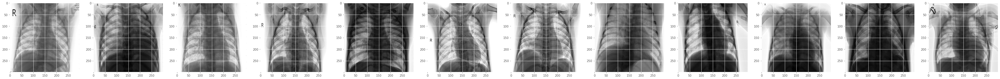

In [14]:
# Menampilkan 12 list/kumpulan gambar dari paru-paru yang terindikasi penyakit pneumonia dengan cara melakukan perulangan
for pneumonia in range (1):
    fig, axs = plt.subplots(1, 12, figsize=(60, 55))
    print("Kumpulan Gambar Paru-Paru yang Terkena Penyakit Pneumonia dari Label Viral Pneumonia: ")
    pneumonia = list(pneumonia_data)
    pneumonia_path = [k for k in pneumonia_data]
    
    for i in range (12):
        pneumonia_imgs = keras.preprocessing.image.img_to_array(
            keras.preprocessing.image.load_img(pneumonia_path[i], color_mode="grayscale"))
        axs[i].imshow(pneumonia_imgs, cmap="Greys")
    plt.show()

Berdasarkan dari script diatas terdapat beberapa penjelasan yang harus diketahui dan berikut adalah penjelasannya:

1. for pneumonia in range (1) dan for i in range (12) merupakan teknik dalam membuat konsep perulangan yang digunakan dalam eksperimen kali ini yang bertujuan untuk menampilkan data gambar dengan status kategori paru-paru pneumonia. Range (1) tersebut berfungsi hanya untuk menampilkan 1 bagian yang nantinya akan menampung gambar-gambar yang berjumlah dua belas paru-paru pneumonia dari hasil scan x-ray karena maksud dari range (12) adalah menampilkan gambar sebanyak 12x. Jika gambar sudah di-load 12 kali maka perulangan akan dihentikan.
2. fig dan axs adalah figure dan axis yang memiliki perbedaan fungsi namun tetap saling berkaitan. Fig/figure merupakan halaman objek visual tempat letaknya gambar. Kemudian axs/axis merupakan area yang dimana tempat diletakkannya data gambar tersebut.
3. plt.subplots(1, 12, figsize=(60, 55)) bertujuan untuk menempatkan/memasukkan gambar dengan sifat vertikal pada 1 figure (fig) yang mencakup gambar dari indeks pertama hingga indeks dua belas dengan ukuran yaitu 60 untuk panjang 1 gambar dan 55 untuk lebar dalam 1 gambar. Jadi intinya kumpulan gambar yang ditampilkan hanya sebanyak 12 gambar saja.
4. Variabel "pneumonia" yang berisikan list dari variabel "pneumonia_data" memiliki tujuan yaitu variabel "pneumonia" mengambil semua isi data yang ada di dalam variabel "pneumonia_data" dan ditampilkan ke dalam bentuk list.
5. Variabel "pneumonia_paths" terkoneksi atau sangat berkaitan dengan variabel "pneumonia_imgs" yang dimana kedua variabel ini bertujuan untuk melakukan proses load data gambar ke dalam tempat figure yang telah disiapkan. Gambar-gambar tersebut nantinya akan di-load sebanyak 12 kali dan jika sudah 12x gambar ditampilkan maka proses perulangan akan segera berhenti.
6. axs[i].imshow bertujuan untuk menampilkan gambar-gambar yang berhasil di-load ke dalam figure dan nantinya figure tersebut akan terbagi menjadi 12 axis/12 bagian (sesuai dengan gambar yang ingin ditampilkan).

### 2.3. Menampilkan 35 Gambar X-Ray Paru-Paru yaitu Covid-19, Lung Opacity, Normal dan Pneumonia

#### 2.3.1. Gambar X-Ray dari Paru-Paru dengan Status Covid-19

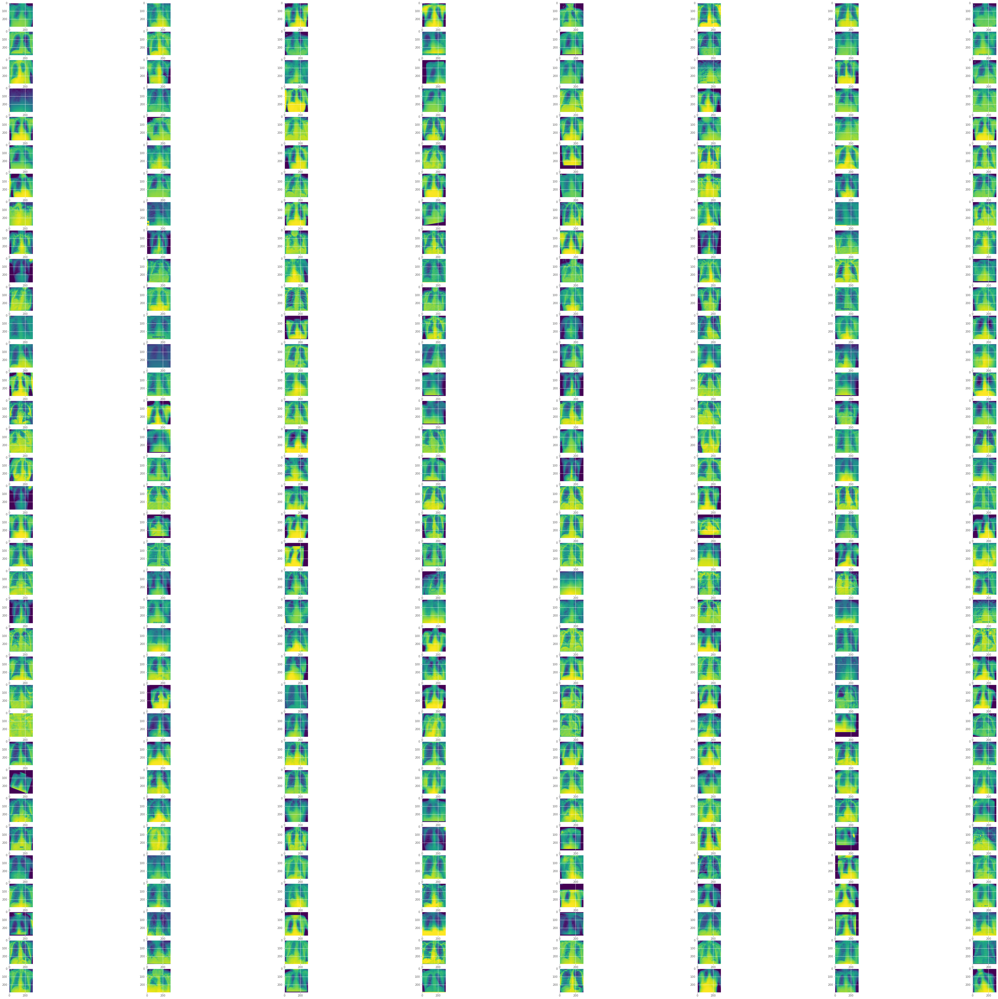

In [15]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena virus covid-19
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_covid_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_covid_images + 1)
    images = plt.imread(covid19_data[multiple_covid_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.2. Gambar X-Ray dari Paru-Paru dengan Status Long Opacity

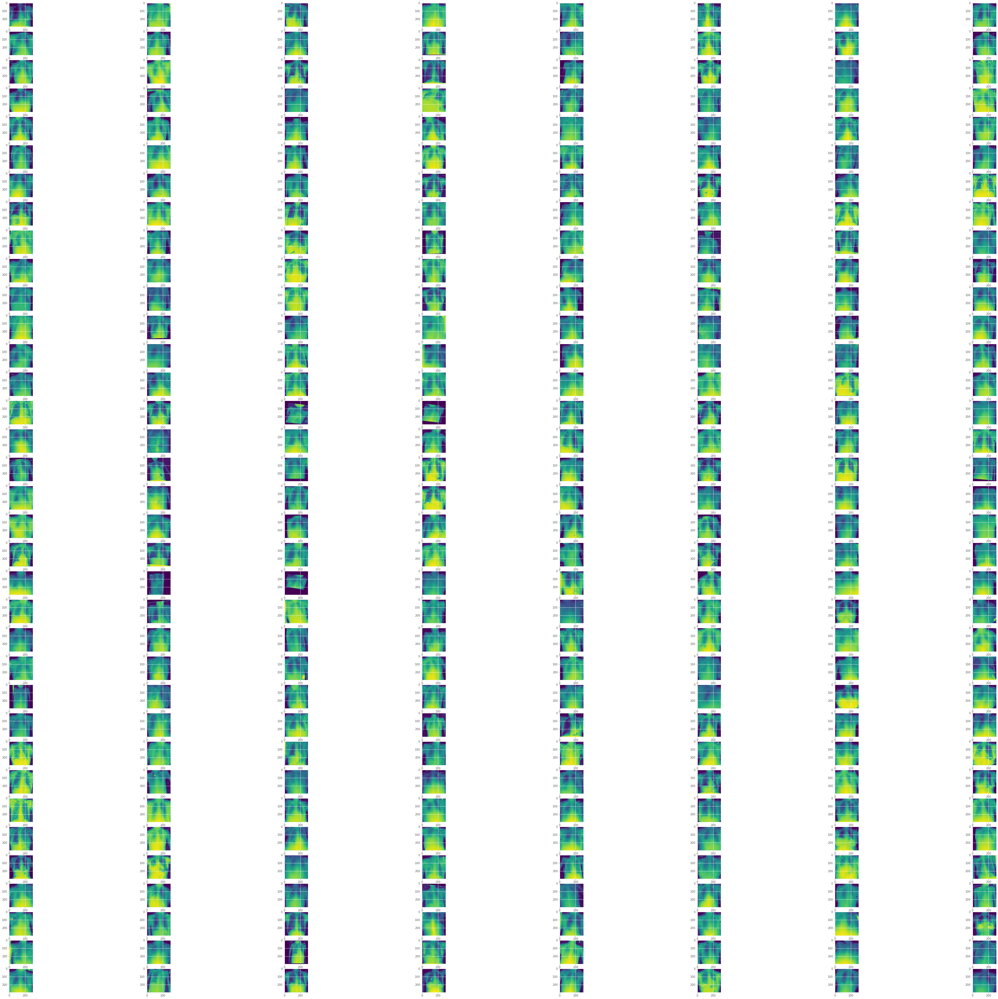

In [16]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena lung opacity
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_lung_opacity_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_lung_opacity_images + 1)
    images = plt.imread(lung_opacity_data[multiple_lung_opacity_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.3. Gambar X-Ray dari Paru-Paru dengan Status Normal

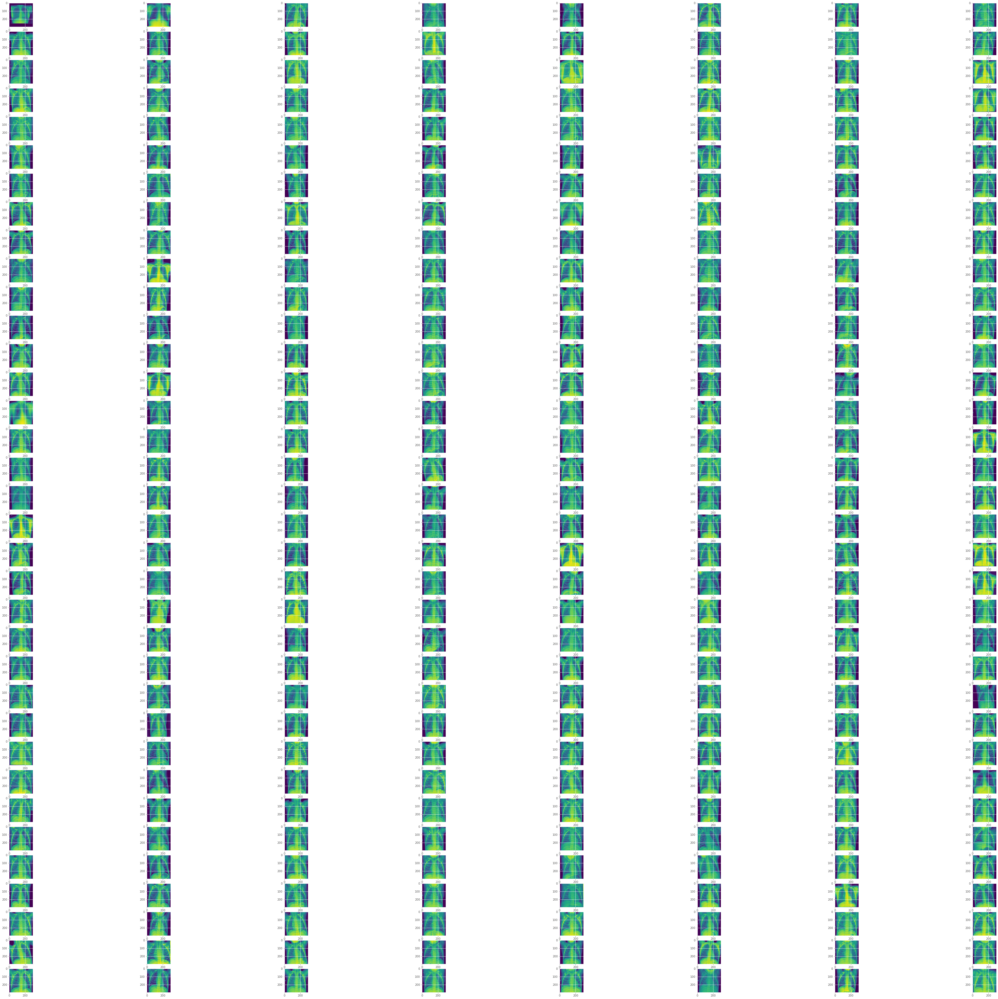

In [17]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru dengan status/kategori normal
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_normal_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_normal_images + 1)
    images = plt.imread(normal_data[multiple_normal_images])
    plt.imshow(images)
    
plt.show()

#### 2.3.4. Gambar X-Ray dari Paru-Paru dengan Status Pneumonia

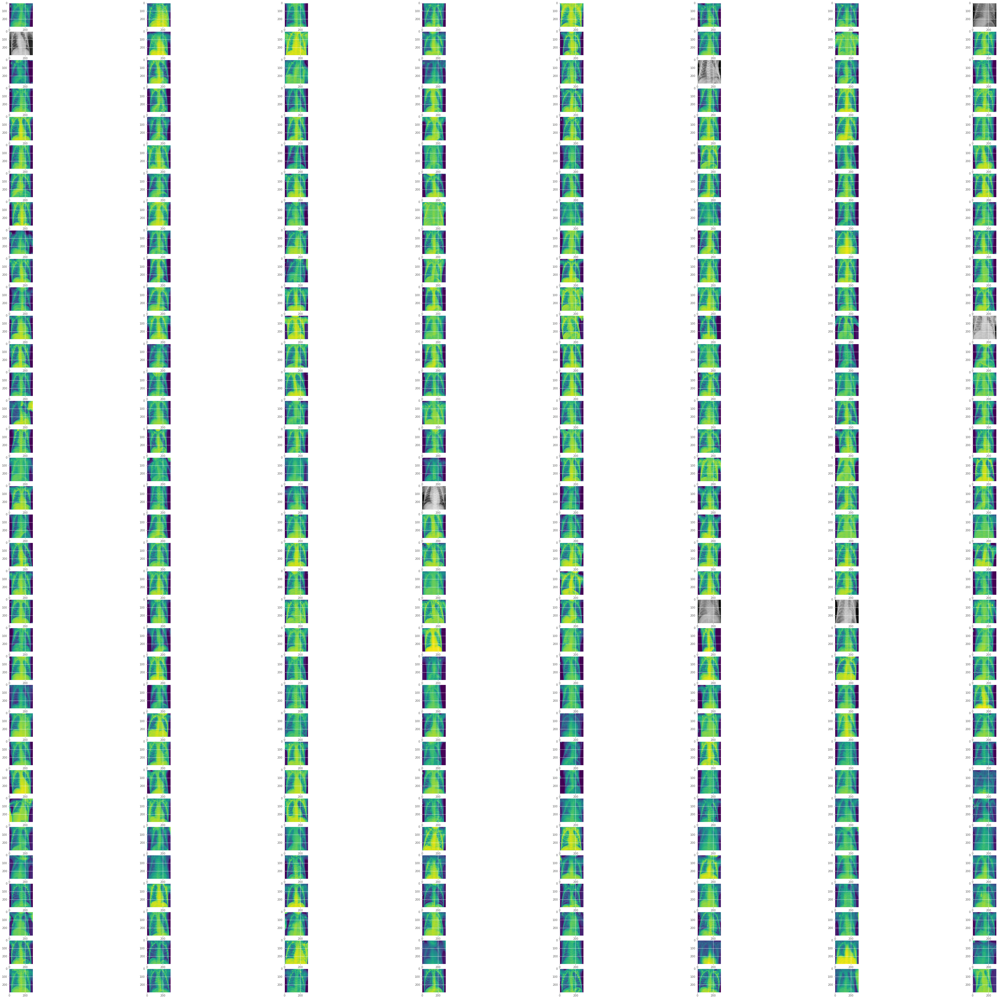

In [18]:
# Menampilkan 35 gambar yang diisi ke dalam 8 kolom yang berupa hasil x-ray paru-paru yang terkena atau dengan status pneumonia
fig = plt.figure(figsize=(70, 66))

rows = 35 # Baris code ini bertujuan untuk menampilkan 35 gambar hasil x-ray yang nantinya akan disesuaikan oleh kolom
cols = 8 # Baris code ini bertujuan untuk memasukkan gambar-gambar hasil x-ray ke dalam kolom-kolom yang telah disiapkan

# Melakukan proses perulangan untuk menampilkan gambar sebanyak 35 baris yang diinput ke dalam 8 kolom
for multiple_pneumonia_images in range(0, rows * cols):
    fig.add_subplot(rows, cols, multiple_pneumonia_images + 1)
    images = plt.imread(pneumonia_data[multiple_pneumonia_images])
    plt.imshow(images)
    
plt.show()

## 3. Image Preprocessing

### 3.1. Convert to Grayscale

#### 3.1.1 COVID

In [19]:
import glob

path = covid19_images_data # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/COVID' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,gray)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil) 
        gray_image = cv2.cvtColor(os.path.join(path,image), cv2.COLOR_BGR2GRAY) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil),gray_image)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


#### 3.1.2 Lung Opacity

In [20]:
path = lung_opacity_images_data # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/Lung_Opacity' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,gray)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil) 
        gray_image = cv2.cvtColor(os.path.join(path,image), cv2.COLOR_BGR2GRAY) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil),gray_image)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


#### 3.1.3 Normal

In [21]:
path = normal_images_data # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/Normal' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,gray)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil) 
        gray_image = cv2.cvtColor(os.path.join(path,image), cv2.COLOR_BGR2GRAY) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil),gray_image)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


#### 3.1.4 Viral Pneumonia

In [22]:
path = pneumonia_images_data # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/Viral Pneumonia' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,gray)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil) 
        gray_image = cv2.cvtColor(os.path.join(path,image), cv2.COLOR_BGR2GRAY) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil),gray_image)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


### 3.2. Median Filter

#### 3.2.1 COVID

In [23]:
path = 'COVID-19_Radiography_Dataset_PreProcessed/COVID' # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/COVID' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        medianFilter = cv2.medianBlur(img, 3)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,medianFilter)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil)
        median_filtered_img = cv2.medianBlur(os.path.join(path,image), 5) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil), median_filtered_img)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


#### 3.2.2 Lung Opacity

In [24]:
path = 'COVID-19_Radiography_Dataset_PreProcessed/Lung_Opacity' # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/Lung_Opacity' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        medianFilter = cv2.medianBlur(img, 3)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,medianFilter)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil)
        median_filtered_img = cv2.medianBlur(os.path.join(path,image), 5) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil), median_filtered_img)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


#### 3.2.3 Normal

In [25]:
path = 'COVID-19_Radiography_Dataset_PreProcessed/Normal' # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/Normal' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        medianFilter = cv2.medianBlur(img, 3)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,medianFilter)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil)
        median_filtered_img = cv2.medianBlur(os.path.join(path,image), 5) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil), median_filtered_img)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


#### 3.2.4 Viral Pneumonia

In [26]:
path = 'COVID-19_Radiography_Dataset_PreProcessed/Viral Pneumonia' # Source Folder
dstpath = 'COVID-19_Radiography_Dataset_PreProcessed/Viral Pneumonia' # Destination Folder
try:
    makedirs(dstpath)
except:
    print ("Directory already exist, images will be written in same folder")
# Folder won't used
files = list(filter(lambda f: isfile(join(path,f)), listdir(path)))
for image in files:
    try:
        img = cv2.imread(os.path.join(path,image))
        medianFilter = cv2.medianBlur(img, 3)
        dstPath = join(dstpath,image)
        cv2.imwrite(dstPath,medianFilter)
    except:
        print ("{} is not converted".format(image))
for fil in glob.glob("*.png"):
    try:
        image = cv2.imread(fil)
        median_filtered_img = cv2.medianBlur(os.path.join(path,image), 5) # convert to greyscale
        cv2.imwrite(os.path.join(dstpath,fil), median_filtered_img)
    except:
        print('{} is not converted')

Directory already exist, images will be written in same folder


### 3.3. Data Augmentation

In [27]:
"""
Melakukan proses augmentasi gambar agar saat proses pelatihan dengan algoritma ResNet 152 v2
memiliki banyak variasi data yang berasal dari 4 label yaitu COVID, Lung_Opacity, Normal dan Viral Pneumonia
Augmentasi gambar yang akan dilakukan di dalam eksperimen ini adalah vertical_flip, horizontal_flip,
rotation_range, width_shift_range, height_shift_range, shear_range, validation_split dan brightness_range
"""

"""
Proses augmentasi pada setiap data gambar untuk keempat label kategori yaitu COVID, Lung_Opacity,
Normal, Viral Pneumonia yang akan digunakan dalam proses pelatihan algoritma dengan data latih
"""
data_train_augmentation = ImageDataGenerator(vertical_flip=True, horizontal_flip=True, rotation_range=40,
                                             width_shift_range=0.2, height_shift_range=0.2, shear_range=0.3,
                                             rescale=None, validation_split=0.2, brightness_range=(0.8, 1.1))

# Proses augmentasi pada setiap data gambar yang bertujuan untuk menguji algoritma dengan data latihnya
data_test_augmentation = ImageDataGenerator(rescale=None, validation_split=0.2)

### 3.4. Saving Images after Augmented Proccess into 4 Different Labels (COVID, Lung_Opacity, Normal and Viral Pneumonia)

#### 3.4.1. COVID Label

In [28]:
"""
Menyimpan sampel gambar hanya untuk indeks pertama dari label COVID
sebagai langkah dokumentasi atas proses eksperimen yang dilakukan
serta untuk melihat perbedaan antara gambar dengan label
COVID yang belum di augmentasi dengan gambar yang telah dilakukan proses augmentasi
"""

# Variabel "base_path" merupakan sumber/dataset asal yang sebelumnya telah di-convert grayscale dan menggunakan median filter
base_path = "COVID-19_Radiography_Dataset_PreProcessed/"

"""
Melakukan proses looping (perulangan) dengan mengambil sampel gambar
berlabel COVID hanya pada indeks gambar pertama untuk disimpan di dalam folder
yang bernama "Image_Dataset_After_Augmentation_Process/COVID"
"""
for save_image_after_augmented in range(1):
    # Fungsi "load_img" adalah untuk membaca seluruh gambar dari label COVID untuk dikonversikan ke dalam array numpy
    img = load_img(base_path + "COVID/" + os.listdir(base_path + "COVID/")[random.randrange(1, 1796)])
    
    x = img_to_array(img) # Menerima seluruh gambar yang telah di-load pada variabel "img" untuk dikonversi ke dalam array numpy
    x = x.reshape((1, ) + x.shape) # Mengubah ukuran seluruh gambar yang telah dikonversi dengan array numpy
    
    """
    Melakukan proses looping dengan menyimpan data gambar dengan label COVID yang telah dilakukan proses
    augmentasi ditahap 3.3 Data Augmentation yang hasil augmentasi disimpan di dalam variabel "data_train_augmentation"
    ke dalam folder tujuan yang bernama "COVID-19_Radiography_Dataset_Augmentation/ResNet_152v2/COVID" berformat .png
    """
    i = 0
    for batch in data_train_augmentation.flow(x, batch_size=32, shuffle=True, seed=22,
                                              save_to_dir="Image_Dataset_After_Augmentation_Process/ResNet_152v2/COVID",
                                              save_prefix="COVID", save_format="png"):
        i += 1
        if i > 10:
            break

In [29]:
"""
Menampilkan jumlah data x-ray dari label COVID yang ada di dalam
folder "Image_Dataset_After_Augmentation_Process" dengan sub-folder "/ResNet_152v2/COVID"
"""
print(str(len(os.listdir("Image_Dataset_After_Augmentation_Process/ResNet_152v2/COVID"))) + " " + "COVID" + " images")

11 COVID images


#### 3.4.2. Lung_Opacity Label

In [30]:
"""
Menyimpan sampel gambar hanya untuk indeks pertama dari label Lung_Opacity
sebagai langkah dokumentasi atas proses eksperimen yang dilakukan
serta untuk melihat perbedaan antara gambar dengan label
Lung_Opacity yang belum di augmentasi dengan gambar yang telah dilakukan proses augmentasi
"""

# Variabel "base_path" merupakan sumber/dataset asal yang sebelumnya telah di-convert grayscale dan menggunakan median filter
base_path = "COVID-19_Radiography_Dataset_PreProcessed/"

"""
Melakukan proses looping (perulangan) dengan mengambil sampel gambar
berlabel Lung_Opacity hanya pada indeks gambar pertama untuk disimpan di dalam folder
yang bernama "Image_Dataset_After_Augmentation_Process/Lung_Opacity"
"""
for save_image_after_augmented in range(1):
    # Fungsi "load_img" adalah untuk membaca seluruh gambar dari label Lung_Opacity untuk dikonversikan ke dalam array numpy
    img = load_img(base_path + "Lung_Opacity/" + os.listdir(base_path + "Lung_Opacity/")[random.randrange(1, 1999)])
    
    x = img_to_array(img) # Menerima seluruh gambar yang telah di-load pada variabel "img" untuk dikonversi ke dalam array numpy
    x = x.reshape((1, ) + x.shape) # Mengubah ukuran seluruh gambar yang telah dikonversi dengan array numpy
    
    """
    Melakukan proses looping dengan menyimpan data gambar dengan label Lung_Opacity yang telah dilakukan
    proses augmentasi ditahap 3.3 Data Augmentation yang hasil augmentasi disimpan di dalam variabel
    "data_train_augmentation" ke dalam folder tujuan yang bernama
    "COVID-19_Radiography_Dataset_Augmentation/ResNet_152v2/ReNet_152v2/Lung_Opacity" berformat .png
    """
    i = 0
    for batch in data_train_augmentation.flow(x, batch_size=32, shuffle=True, seed=22,
                                              save_to_dir="Image_Dataset_After_Augmentation_Process/ResNet_152v2/Lung_Opacity",
                                              save_prefix="Lung_Opacity", save_format="png"):
        i += 1
        if i > 10:
            break

In [31]:
"""
Menampilkan jumlah data x-ray dari label Lung_Opacity yang ada di dalam
folder "Image_Dataset_After_Augmentation_Process" dengan sub-folder "/ResNet_152v2//Lung_Opacity"
"""
print(str(len(os.listdir("Image_Dataset_After_Augmentation_Process/ResNet_152v2/Lung_Opacity"))) + " " 
      + "Lung_Opacity" + " images")

11 Lung_Opacity images


#### 3.4.3. Normal Label

In [32]:
"""
Menyimpan sampel gambar hanya untuk indeks pertama dari label Normal
sebagai langkah dokumentasi atas proses eksperimen yang dilakukan
serta untuk melihat perbedaan antara gambar dengan label
Normal yang belum di augmentasi dengan gambar yang telah dilakukan proses augmentasi
"""

# Variabel "base_path" merupakan sumber/dataset asal yang sebelumnya telah di-convert grayscale dan menggunakan median filter
base_path = "COVID-19_Radiography_Dataset_PreProcessed/"

"""
Melakukan proses looping (perulangan) dengan mengambil sampel gambar
berlabel Normal hanya pada indeks gambar pertama untuk disimpan di dalam folder
yang bernama "Image_Dataset_After_Augmentation_Process/Normal"
"""
for save_image_after_augmented in range(1):
    # Fungsi "load_img" adalah untuk membaca seluruh gambar dari label Normal untuk dikonversikan ke dalam array numpy
    img = load_img(base_path + "Normal/" + os.listdir(base_path + "Normal/")[random.randrange(1, 1999)])
    
    x = img_to_array(img) # Menerima seluruh gambar yang telah di-load pada variabel "img" untuk dikonversi ke dalam array numpy
    x = x.reshape((1, ) + x.shape) # Mengubah ukuran seluruh gambar yang telah dikonversi dengan array numpy
    
    """
    Melakukan proses looping dengan menyimpan data gambar dengan label Normal yang telah dilakukan proses
    augmentasi ditahap 3.3 Data Augmentation yang hasil augmentasi disimpan di dalam variabel "data_train_augmentation"
    ke dalam folder tujuan yang bernama "COVID-19_Radiography_Dataset_Augmentation/ResNet_152v2/Normal" berformat .png
    """
    i = 0
    for batch in data_train_augmentation.flow(x, batch_size=32, shuffle=True, seed=22,
                                              save_to_dir="Image_Dataset_After_Augmentation_Process/ResNet_152v2/Normal",
                                              save_prefix="Normal", save_format="png"):
        i += 1
        if i > 10:
            break

In [33]:
"""
Menampilkan jumlah data x-ray dari label Normal yang ada di dalam
folder "Image_Dataset_After_Augmentation_Process" dengan sub-folder "/ResNet_152v2/Normal"
"""
print(str(len(os.listdir("Image_Dataset_After_Augmentation_Process/ResNet_152v2/Normal"))) + " " + "Normal" + " images")

11 Normal images


#### 3.4.4. Viral Pneumonia Label

In [34]:
"""
Menyimpan sampel gambar hanya untuk indeks pertama dari label Viral Pneumonia
sebagai langkah dokumentasi atas proses eksperimen yang dilakukan
serta untuk melihat perbedaan antara gambar dengan label
Viral Pneumonia yang belum di augmentasi dengan gambar yang telah dilakukan proses augmentasi
"""

# Variabel "base_path" merupakan sumber/dataset asal yang sebelumnya telah di-convert grayscale dan menggunakan median filter
base_path = "COVID-19_Radiography_Dataset_PreProcessed/"

"""
Melakukan proses looping (perulangan) dengan mengambil sampel gambar
berlabel Viral Pneumonia hanya pada indeks gambar pertama untuk disimpan di dalam folder
yang bernama "Image_Dataset_After_Augmentation_Process/Viral Pneumonia"
"""
for save_image_after_augmented in range(1):
    # Fungsi "load_img" adalah untuk membaca seluruh gambar dari label Viral Pneumonia untuk dikonversikan ke dalam array numpy
    img = load_img(base_path + "Viral Pneumonia/" + os.listdir(base_path + "Viral Pneumonia/")[random.randrange(1, 1344)])
    
    x = img_to_array(img) # Menerima seluruh gambar yang telah di-load pada variabel "img" untuk dikonversi ke dalam array numpy
    x = x.reshape((1, ) + x.shape) # Mengubah ukuran seluruh gambar yang telah dikonversi dengan array numpy
    
    """
    Melakukan proses looping dengan menyimpan data gambar dengan label Viral Pneumonia yang telah dilakukan proses
    augmentasi ditahap 3.3 Data Augmentation yang hasil augmentasi disimpan di dalam variabel "data_train_augmentation"
    ke dalam folder tujuan yang bernama "COVID-19_Radiography_Dataset_Augmentation/ResNet_152v2/Viral Pneumonia" berformat .png
    """
    i = 0
    for batch in data_train_augmentation.flow(x, batch_size=32, shuffle=True, seed=22,
                                              save_to_dir="Image_Dataset_After_Augmentation_Process/ResNet_152v2/Viral Pneumonia",
                                              save_prefix="Viral Pneumonia", save_format="png"):
        i += 1
        if i > 10:
            break

In [35]:
"""
Menampilkan jumlah data x-ray dari label Viral Pneumonia yang ada di dalam
folder "Image_Dataset_After_Augmentation_Process" dengan sub-folder "/ResNet_152v2/Viral Pneumonia"
"""
print(str(len(os.listdir("Image_Dataset_After_Augmentation_Process/ResNet_152v2/Viral Pneumonia"))) + 
      " " + "Viral Pneumonia" + " images")

11 Viral Pneumonia images


### 3.4. Splitting

In [36]:
"""
Memasukkan variabel data_train_augmentation yang bertujuan untuk memberikan
variasi data-data baru ke dalam data pelatihan/data training serta juga memasukkan
variabel data_test_augmentation yang di dalamnya terdapat nilai hasil split saja
"""

training_generator = data_train_augmentation.flow_from_directory("COVID-19_Radiography_Dataset_PreProcessed",
                                                                 target_size=(100, 100),
                                                                 subset="training",
                                                                 classes=None,
                                                                 color_mode="rgb",
                                                                 class_mode="categorical",
                                                                 shuffle=True,
                                                                 seed=22,
                                                                 batch_size=32)

print()

testing_generator = data_test_augmentation.flow_from_directory("COVID-19_Radiography_Dataset_PreProcessed",
                                                               target_size=(100, 100),
                                                               subset="validation",
                                                               classes=None,
                                                               color_mode="rgb",
                                                               class_mode="categorical",
                                                               shuffle=False,
                                                               seed=22,
                                                               batch_size=32)

Found 5714 images belonging to 4 classes.

Found 1428 images belonging to 4 classes.


In [37]:
# Melihat nama-nama dari kelas yang digunakan dalam pengujian kali ini, baik dari training generator atau testing generator

# Khusus untuk nama-nama kelas dari dictionary data latih
class_dictionary_train = training_generator.class_indices
class_dictionary_train = { value:key for key, value in class_dictionary_train.items()}
"""
Melakukan proses konversi dictionary (class_dictionary_train) yang telah
berisikan nama-nama label dari masing-masing gambar di data latih ke dalam list
"""
class_list_train = [value for _,value in class_dictionary_train.items()]
print(class_list_train)

# Khusus untuk nama-nama kelas dari dictionary data uji
class_dictionary_test = testing_generator.class_indices
class_dictionary_test = { value:key for key, value in class_dictionary_test.items()}
"""
Melakukan proses konversi dictionary (class_dictionary_test) yang telah
berisikan nama-nama label dari masing-masing gambar di data uji ke dalam list
"""
class_list_test = [value for _,value in class_dictionary_test.items()]
print(class_list_test)

['COVID', 'Lung_Opacity', 'Normal', 'Viral Pneumonia']
['COVID', 'Lung_Opacity', 'Normal', 'Viral Pneumonia']


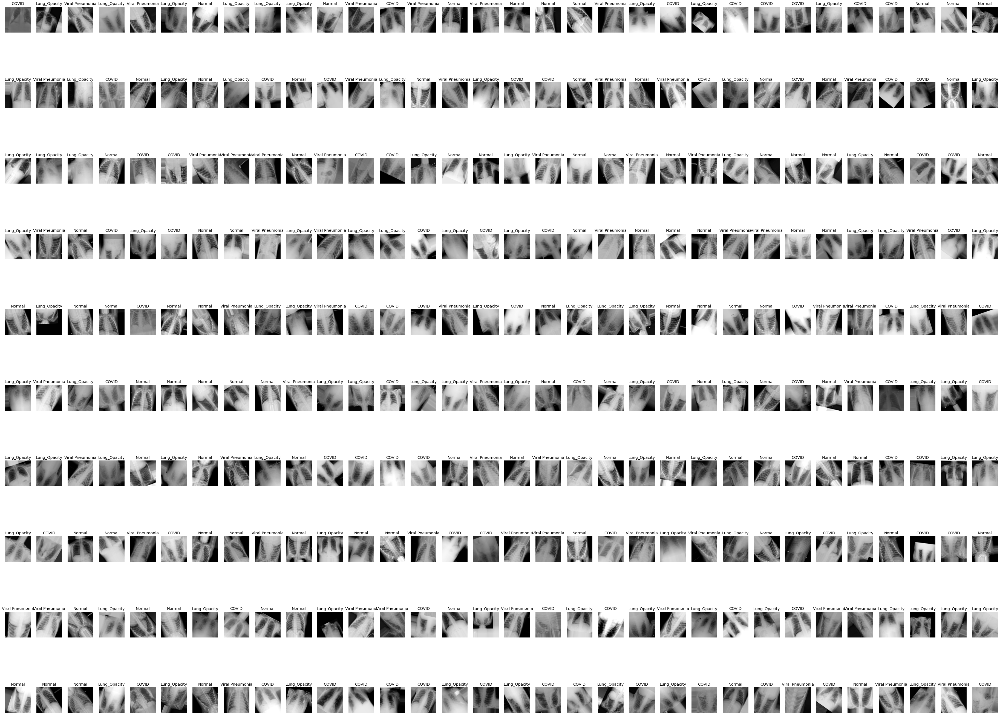

In [38]:
"""
Menampilkan beberapa data gambar dari keempat label (COVID-19, Lung_Opacity,
Normal, Viral Pneumonia) setelah melakukan proses augmentasi gambar di data training
"""
rows = 10
batch_size = 32
fig, axes = plt.subplots(rows, batch_size)

for r in range(rows):
    image_batch = training_generator.next()    
    images_count = image_batch[0].shape[0]
    
    for c in range(images_count):
        image = image_batch[0][c].astype("uint8")
        axes[r, c].imshow(image)
        axes[r, c].title.set_text(class_list_train[np.argmax(image_batch[1][c])])
        axes[r, c].set_xticks([])
        axes[r, c].set_yticks([])
fig.set_size_inches(65, 50)

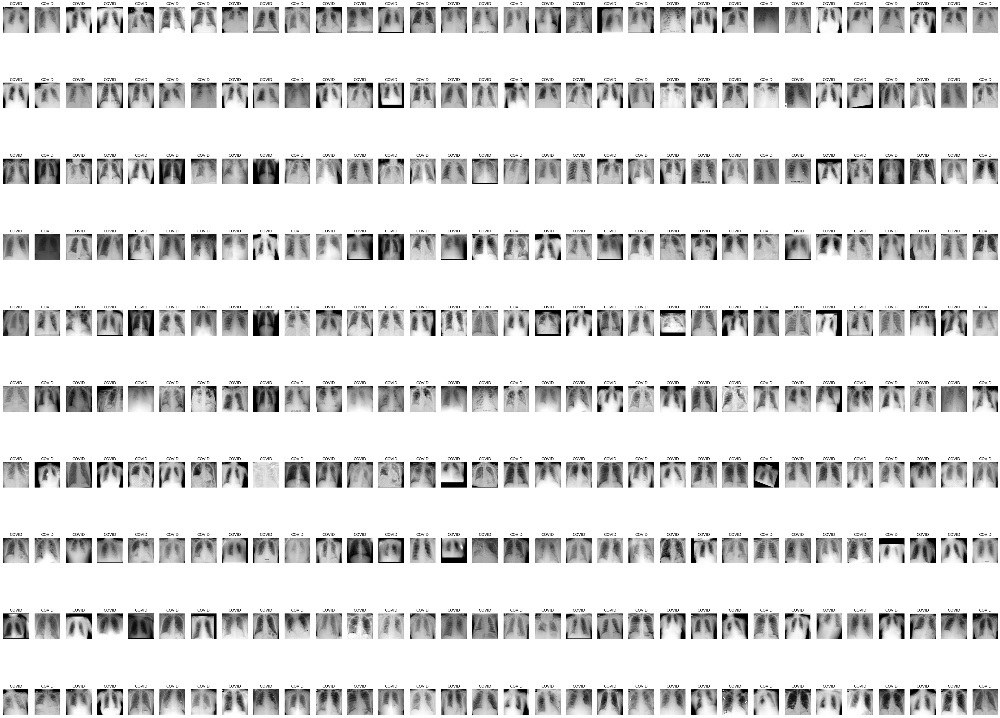

In [39]:
"""
Menampilkan beberapa data gambar dari keempat label (COVID-19, Lung_Opacity,
Normal, Viral Pneumonia) setelah melakukan proses augmentasi gambar (validation split dan rescale) di data testing
"""
rows = 10
batch_size = 32
fig, axes = plt.subplots(rows, batch_size)

for r in range(rows):
    image_batch = testing_generator.next()    
    images_count = image_batch[0].shape[0]
    
    for c in range(images_count):
        image = image_batch[0][c].astype("uint8")
        axes[r,c].imshow(image)
        axes[r,c].title.set_text(class_list_test[np.argmax(image_batch[1][c])])
        axes[r,c].set_xticks([])
        axes[r,c].set_yticks([])
fig.set_size_inches(65, 50)

## 4. Image Modelling with ResNet 152 v2 Algorithm and Showing the Graphs from Loss, Validation Loss, Accuracy and Validation Accuracy

### 4.1. ResNet 152 v2 Algorithm

In [40]:
"""
Membuat/menyusun jaringan syaraf tiruan (neural networks) dengan menggunakan algoritma ResNet 152 versi 2
dari keras dan juga menyusun lapisan tersembunyi, layar flatten, dll, 
serta menampilkan hasil dari proses pembuatan jaringan syaraf tiruan berdasarkan algoritma ResNet 152 v2
"""

ResNet_algorithm_152v2 = Sequential()

"""
Mengimplementasikan penyusunan struktur layer dari algoritma
ResNet 152 versi 2 dengan menginisialisasikan hyperparameter yang dibutuhkan dari algoritma ResNet 152 v2
"""
ResNet152_v2_network = ResNet152V2(
    input_shape=(100, 100, 3),
    include_top=False,
    pooling="avg",
    weights="imagenet",
    classes=4,
    classifier_activation="softmax",
)

# Layer yang berisikan model ResNet 152 v2 yang didalamnya telah terdapat 6 parameter beserta nilai-nilainya
ResNet_algorithm_152v2.add(ResNet152_v2_network)

ResNet_algorithm_152v2.add(Flatten())
ResNet_algorithm_152v2.add(BatchNormalization())

ResNet_algorithm_152v2.add(Dense(185, activation="relu"))

ResNet_algorithm_152v2.add(Dense(150, activation="relu"))
ResNet_algorithm_152v2.add(Dropout(0.4))

ResNet_algorithm_152v2.add(BatchNormalization())
ResNet_algorithm_152v2.add(Dropout(0.3))

ResNet_algorithm_152v2.add(Dense(120))
ResNet_algorithm_152v2.add(Dropout(0.3))

ResNet_algorithm_152v2.add(Dense(73, activation="relu"))

ResNet_algorithm_152v2.add(Dense(40, activation="relu"))

ResNet_algorithm_152v2.add(Dense(4, activation="softmax"))

"""
Memanggil fungsi optimasi dan learning rate yang akan digunakan di dalam
strukur jaringan syaraf dari ResNet 152 versi 2 dan nilai variabel optimasi yang akan digunakan
dalam pengujian kali ini adalah SGD dengan nilai learning_rate sebesar 0.01
"""
optimizer = SGD(learning_rate=0.01)
 
# Menyusun jaringan yang telah dibuat berdasarkan optimizer yang digunakan
ResNet_algorithm_152v2.compile(optimizer=optimizer, loss="categorical_crossentropy", metrics=["accuracy"])

# Melihat susunan jaringan syaraf tiruan
ResNet_algorithm_152v2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resnet152v2 (Functional)    (None, 2048)              58331648  
                                                                 
 flatten (Flatten)           (None, 2048)              0         
                                                                 
 batch_normalization (BatchN  (None, 2048)             8192      
 ormalization)                                                   
                                                                 
 dense (Dense)               (None, 185)               379065    
                                                                 
 dense_1 (Dense)             (None, 150)               27900     
                                                                 
 dropout (Dropout)           (None, 150)               0         
                                                        

Dalam menyusun jaringan syaraf tiruan dengan model ResNet (Residual Network) 152 v2, saya menggunakan beberapa layer didalamnya. Layer pertama tentu saja layer dari model ResNet 152 v2 yang dimuat di dalam variabel "ResNet152_v2_network". Pada variabel tersebut berisikan 6 parameter dari model ResNet 152 v2 yang saya panggil dari library keras. Setelah menginisialisasi parameter-parameter dari model ResNet 152 v2, selannjutnya saya jadikan variabel tersebut di layer pertama pada eksperimen ini.

Selanjutnya saya menambahkan proses flattening dan batch normalization yang kedua proses tersebut memiliki tugasnya masing-masing. Proses flatten berfungsi untuk mengubah nilai-nilai matriks menjadi sebuah vektor tunggal saja. Penggambarannya seperti ini. Sebuah gambar pasti memiliki kumpulan nilai-nilai matriks yang menyusun gambar tersebut bukan? Nah, dengan menggunakan flatten maka kumpulan nilai-nilai yang berada di dalam matriks data gambar tersebut akan dijadikan satu kolom saja atau sebuah vektor tunggal yang nantinya vektor tunggal ini (yang didalamnya telah terdapat kumpulan nilai dari matriks gambar) akan menjadi bagian dari layer input dari model yang akan digunakan (dalam kasus ini akan dijadikan sebagai layer input ResNet 152 v2). Sedangkan tahap batch normalization berfungsi untuk memproses jaringan syaraf yang telah dibuat menjadi lebih stabil dengan menambahkan ekstra layer di jaringan syaraf untuk menghindari terjadinya over-fitting terhadap hasil performa.

Referensi dari tahap flatten dan batch normalization:

- https://www.megabagus.id/deep-learning-convolutional-neural-networks/6/

- https://www.analyticsvidhya.com/blog/2021/03/introduction-to-batch-normalization/

Selain batch normalization dan flatten, script diatas terdapat 2 nilai dari activation function. Activation function berfungsi untuk mendefinisikan nilai output dari layer input. Activation function dapat memutuskan untuk mengaktifkan/menonaktifkan neuron yang ada di layer input agar mendapatkan hasil (output) yang diinginkan dengan memperhitungkan jumlah nilai bobot dalam setiap neuron dan menambahkan bias. Jadi activation function tidak hanya dilakukan oleh model lienar tetapi juga dapat dilakukan/dimasukkan nilai yang non-linear ke dalam output pada setiap neuron.
Activation function yang saya gunakan pada eksperimen kali ini ada 2 yaitu ReLu dan Softmax. Fungsi aktivasi relu merupakan fungsi aktivasi yang sangat sering digunakan yang memiliki range dari 0 - tak terhingga (infinity values). Bahkan jika terdapat nilai negatif maka ReLu akan mengubah/mentransformasikan semua nilai negatif menjadi nol. Lalu fungsi aktivasi softmax merupakan fungsi aktivasi yang sangat sering digunakan pada lapisan terakhir (output layer) untuk pengambilan keputusan dengan memberikan nilai pada input sesuai dengan bobotnya dan jumlah bobot ini akhirnya menjadi satu.

Referensi dari penjelasan activation function, ReLu, dan Softmax:

- https://www.analyticssteps.com/blogs/7-types-activation-functions-neural-network

- https://www.geeksforgeeks.org/activation-functions-neural-networks/

In [41]:
"""
Menampilkan susunan layer original (layer asli) dari algoritma
ResNet 152 v2 dengan parameter-parameter yang sudah ditentukan
pada script sebelummnya di dalam ResNet 152 v2.
Struktur layer ini tidak memiliki layer tersembunyi (hidden layer), layer flatten,
fungsi batch normalization dan beberapa layer lainnya
"""
ResNet152_v2_network.summary()

Model: "resnet152v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 100, 100, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 106, 106, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 50, 50, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 pool1_pad (ZeroPadding2D)      (None, 52, 52, 64)   0           ['conv1_conv[0][0]']   

 vation)                                                                                          
                                                                                                  
 conv2_block3_1_conv (Conv2D)   (None, 25, 25, 64)   16384       ['conv2_block3_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv2_block3_1_bn (BatchNormal  (None, 25, 25, 64)  256         ['conv2_block3_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_block3_1_relu (Activatio  (None, 25, 25, 64)  0           ['conv2_block3_1_bn[0][0]']      
 n)                                                                                               
          

 conv3_block2_2_bn (BatchNormal  (None, 13, 13, 128)  512        ['conv3_block2_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block2_2_relu (Activatio  (None, 13, 13, 128)  0          ['conv3_block2_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block2_3_conv (Conv2D)   (None, 13, 13, 512)  66048       ['conv3_block2_2_relu[0][0]']    
                                                                                                  
 conv3_block2_out (Add)         (None, 13, 13, 512)  0           ['conv3_block1_out[0][0]',       
                                                                  'conv3_block2_3_conv[0][0]']    
          

 ization)                                                                                         
                                                                                                  
 conv3_block5_1_relu (Activatio  (None, 13, 13, 128)  0          ['conv3_block5_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block5_2_pad (ZeroPaddin  (None, 15, 15, 128)  0          ['conv3_block5_1_relu[0][0]']    
 g2D)                                                                                             
                                                                                                  
 conv3_block5_2_conv (Conv2D)   (None, 13, 13, 128)  147456      ['conv3_block5_2_pad[0][0]']     
                                                                                                  
 conv3_blo

 conv3_block8_preact_bn (BatchN  (None, 13, 13, 512)  2048       ['conv3_block7_out[0][0]']       
 ormalization)                                                                                    
                                                                                                  
 conv3_block8_preact_relu (Acti  (None, 13, 13, 512)  0          ['conv3_block8_preact_bn[0][0]'] 
 vation)                                                                                          
                                                                                                  
 conv3_block8_1_conv (Conv2D)   (None, 13, 13, 128)  65536       ['conv3_block8_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv3_block8_1_bn (BatchNormal  (None, 13, 13, 128)  512        ['conv3_block8_1_conv[0][0]']    
 ization) 

 g2D)                                                                                             
                                                                                                  
 conv4_block2_2_conv (Conv2D)   (None, 7, 7, 256)    589824      ['conv4_block2_2_pad[0][0]']     
                                                                                                  
 conv4_block2_2_bn (BatchNormal  (None, 7, 7, 256)   1024        ['conv4_block2_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block2_2_relu (Activatio  (None, 7, 7, 256)   0           ['conv4_block2_2_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_blo

 conv4_block5_1_conv (Conv2D)   (None, 7, 7, 256)    262144      ['conv4_block5_preact_relu[0][0]'
                                                                 ]                                
                                                                                                  
 conv4_block5_1_bn (BatchNormal  (None, 7, 7, 256)   1024        ['conv4_block5_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block5_1_relu (Activatio  (None, 7, 7, 256)   0           ['conv4_block5_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block5_2_pad (ZeroPaddin  (None, 9, 9, 256)   0           ['conv4_block5_1_relu[0][0]']    
 g2D)     

                                                                                                  
 conv4_block7_out (Add)         (None, 7, 7, 1024)   0           ['conv4_block6_out[0][0]',       
                                                                  'conv4_block7_3_conv[0][0]']    
                                                                                                  
 conv4_block8_preact_bn (BatchN  (None, 7, 7, 1024)  4096        ['conv4_block7_out[0][0]']       
 ormalization)                                                                                    
                                                                                                  
 conv4_block8_preact_relu (Acti  (None, 7, 7, 1024)  0           ['conv4_block8_preact_bn[0][0]'] 
 vation)                                                                                          
                                                                                                  
 conv4_blo

                                                                                                  
 conv4_block10_2_conv (Conv2D)  (None, 7, 7, 256)    589824      ['conv4_block10_2_pad[0][0]']    
                                                                                                  
 conv4_block10_2_bn (BatchNorma  (None, 7, 7, 256)   1024        ['conv4_block10_2_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block10_2_relu (Activati  (None, 7, 7, 256)   0           ['conv4_block10_2_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block10_3_conv (Conv2D)  (None, 7, 7, 1024)   263168      ['conv4_block10_2_relu[0][0]']   
          

                                                                 ']                               
                                                                                                  
 conv4_block13_1_bn (BatchNorma  (None, 7, 7, 256)   1024        ['conv4_block13_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block13_1_relu (Activati  (None, 7, 7, 256)   0           ['conv4_block13_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block13_2_pad (ZeroPaddi  (None, 9, 9, 256)   0           ['conv4_block13_1_relu[0][0]']   
 ng2D)                                                                                            
          

 conv4_block15_out (Add)        (None, 7, 7, 1024)   0           ['conv4_block14_out[0][0]',      
                                                                  'conv4_block15_3_conv[0][0]']   
                                                                                                  
 conv4_block16_preact_bn (Batch  (None, 7, 7, 1024)  4096        ['conv4_block15_out[0][0]']      
 Normalization)                                                                                   
                                                                                                  
 conv4_block16_preact_relu (Act  (None, 7, 7, 1024)  0           ['conv4_block16_preact_bn[0][0]']
 ivation)                                                                                         
                                                                                                  
 conv4_block16_1_conv (Conv2D)  (None, 7, 7, 256)    262144      ['conv4_block16_preact_relu[0][0]
          

 conv4_block18_2_conv (Conv2D)  (None, 7, 7, 256)    589824      ['conv4_block18_2_pad[0][0]']    
                                                                                                  
 conv4_block18_2_bn (BatchNorma  (None, 7, 7, 256)   1024        ['conv4_block18_2_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block18_2_relu (Activati  (None, 7, 7, 256)   0           ['conv4_block18_2_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block18_3_conv (Conv2D)  (None, 7, 7, 1024)   263168      ['conv4_block18_2_relu[0][0]']   
                                                                                                  
 conv4_blo

                                                                                                  
 conv4_block21_1_bn (BatchNorma  (None, 7, 7, 256)   1024        ['conv4_block21_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block21_1_relu (Activati  (None, 7, 7, 256)   0           ['conv4_block21_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block21_2_pad (ZeroPaddi  (None, 9, 9, 256)   0           ['conv4_block21_1_relu[0][0]']   
 ng2D)                                                                                            
                                                                                                  
 conv4_blo

                                                                  'conv4_block23_3_conv[0][0]']   
                                                                                                  
 conv4_block24_preact_bn (Batch  (None, 7, 7, 1024)  4096        ['conv4_block23_out[0][0]']      
 Normalization)                                                                                   
                                                                                                  
 conv4_block24_preact_relu (Act  (None, 7, 7, 1024)  0           ['conv4_block24_preact_bn[0][0]']
 ivation)                                                                                         
                                                                                                  
 conv4_block24_1_conv (Conv2D)  (None, 7, 7, 256)    262144      ['conv4_block24_preact_relu[0][0]
                                                                 ']                               
          

                                                                                                  
 conv4_block26_2_bn (BatchNorma  (None, 7, 7, 256)   1024        ['conv4_block26_2_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block26_2_relu (Activati  (None, 7, 7, 256)   0           ['conv4_block26_2_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block26_3_conv (Conv2D)  (None, 7, 7, 1024)   263168      ['conv4_block26_2_relu[0][0]']   
                                                                                                  
 conv4_block26_out (Add)        (None, 7, 7, 1024)   0           ['conv4_block25_out[0][0]',      
          

 conv4_block29_1_bn (BatchNorma  (None, 7, 7, 256)   1024        ['conv4_block29_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block29_1_relu (Activati  (None, 7, 7, 256)   0           ['conv4_block29_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block29_2_pad (ZeroPaddi  (None, 9, 9, 256)   0           ['conv4_block29_1_relu[0][0]']   
 ng2D)                                                                                            
                                                                                                  
 conv4_block29_2_conv (Conv2D)  (None, 7, 7, 256)    589824      ['conv4_block29_2_pad[0][0]']    
          

                                                                                                  
 conv4_block32_preact_bn (Batch  (None, 7, 7, 1024)  4096        ['conv4_block31_out[0][0]']      
 Normalization)                                                                                   
                                                                                                  
 conv4_block32_preact_relu (Act  (None, 7, 7, 1024)  0           ['conv4_block32_preact_bn[0][0]']
 ivation)                                                                                         
                                                                                                  
 conv4_block32_1_conv (Conv2D)  (None, 7, 7, 256)    262144      ['conv4_block32_preact_relu[0][0]
                                                                 ']                               
                                                                                                  
 conv4_blo

 conv4_block34_2_bn (BatchNorma  (None, 7, 7, 256)   1024        ['conv4_block34_2_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block34_2_relu (Activati  (None, 7, 7, 256)   0           ['conv4_block34_2_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block34_3_conv (Conv2D)  (None, 7, 7, 1024)   263168      ['conv4_block34_2_relu[0][0]']   
                                                                                                  
 conv4_block34_out (Add)        (None, 7, 7, 1024)   0           ['conv4_block33_out[0][0]',      
                                                                  'conv4_block34_3_conv[0][0]']   
          

                                                                                                  
 conv5_block1_1_bn (BatchNormal  (None, 4, 4, 512)   2048        ['conv5_block1_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block1_1_relu (Activatio  (None, 4, 4, 512)   0           ['conv5_block1_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv5_block1_2_pad (ZeroPaddin  (None, 6, 6, 512)   0           ['conv5_block1_1_relu[0][0]']    
 g2D)                                                                                             
                                                                                                  
 conv5_blo

 conv5_block3_3_conv (Conv2D)   (None, 4, 4, 2048)   1050624     ['conv5_block3_2_relu[0][0]']    
                                                                                                  
 conv5_block3_out (Add)         (None, 4, 4, 2048)   0           ['conv5_block2_out[0][0]',       
                                                                  'conv5_block3_3_conv[0][0]']    
                                                                                                  
 post_bn (BatchNormalization)   (None, 4, 4, 2048)   8192        ['conv5_block3_out[0][0]']       
                                                                                                  
 post_relu (Activation)         (None, 4, 4, 2048)   0           ['post_bn[0][0]']                
                                                                                                  
 avg_pool (GlobalAveragePooling  (None, 2048)        0           ['post_relu[0][0]']              
 2D)      

In [42]:
callbackv2 = tf.keras.callbacks.EarlyStopping(
    monitor="val_accuracy",
    min_delta=0.0005,
    patience=30,
    verbose=1,
    mode="auto",
    restore_best_weights=True,
)

In [43]:
"""
Mulai melatih algoritma ResNet 152 v2 dalam 30 kali proses pengulangan dengan menggunakan
data training sekaligus menguji algoritma ResNet 152 v2 dengan beberapa data uji untuk memprediksi hasil pengklasifikasian
"""
historyv2 = ResNet_algorithm_152v2.fit(training_generator, validation_data=testing_generator, epochs=30,
                                       batch_size=32, callbacks=callbackv2)

Epoch 1/30
179/179 [==============================] - 2767s 15s/step - loss: 1.4006 - accuracy: 0.3582 - val_loss: 1.3924 - val_accuracy: 0.2801
Epoch 2/30
179/179 [==============================] - 2654s 15s/step - loss: 1.0338 - accuracy: 0.5408 - val_loss: 0.9114 - val_accuracy: 0.6737
Epoch 3/30
179/179 [==============================] - 2639s 15s/step - loss: 0.8500 - accuracy: 0.6365 - val_loss: 0.9004 - val_accuracy: 0.6856
Epoch 4/30
179/179 [==============================] - 2479s 14s/step - loss: 0.7439 - accuracy: 0.7109 - val_loss: 1.1751 - val_accuracy: 0.7696
Epoch 5/30
179/179 [==============================] - 2428s 14s/step - loss: 0.7084 - accuracy: 0.7308 - val_loss: 0.7981 - val_accuracy: 0.7381
Epoch 6/30
179/179 [==============================] - 2680s 15s/step - loss: 0.6632 - accuracy: 0.7487 - val_loss: 361.9375 - val_accuracy: 0.2815
Epoch 7/30
179/179 [==============================] - ETA: 0s - loss: 0.5977 - accuracy: 0.7758 

KeyboardInterrupt: 

In [44]:
# MODEL_BASE_PATH = "Model"
# PROJECT_NAME = "Resnet152_v2"
# SAVE_MODEL_NAME = "resnet152_v2.h5"
# save_model_path = os.path.join(MODEL_BASE_PATH, PROJECT_NAME, SAVE_MODEL_NAME)

# if os.path.exists(os.path.join(MODEL_BASE_PATH, PROJECT_NAME)) == False:
#     os.makedirs(os.path.join(MODEL_BASE_PATH, PROJECT_NAME))
    
# print('Saving Model At {}...'.format(save_model_path))
# ResNet_algorithm_152v2.save(save_model_path,include_optimizer=False)

### 4.2. Menampilkan Hasil Akhir berupa Nilai Akurasi, Presisi, Recall, F1-Score serta Membuat Grafik Confusion Matrix untuk Hasil Prediksi dari Algoritma ResNet 152 v2

In [45]:
"""
Melihat performa algoritma ResNet 152 v2 dari data training (loss dan accuracy)
dan testing (val_loss dan val_accuracy) menggunakan generator training dan testing
"""
print("Performa Kinerja dari Algoritma ResNet 152 v1 dengan Data Training: ", ResNet_algorithm_152v2.
      evaluate(training_generator), "\n")

print("Performa Kinerja dari Algoritma ResNet 152 v1 dengan Data Testing: ", ResNet_algorithm_152v2.
      evaluate(testing_generator))

179/179 [==============================] - 440s 2s/step - loss: 0.8548 - accuracy: 0.6962
Performa Kinerja dari Algoritma ResNet 152 v1 dengan Data Training:  [0.8548110723495483, 0.6961848139762878] 

45/45 [==============================] - 106s 2s/step - loss: 0.6429 - accuracy: 0.7633
Performa Kinerja dari Algoritma ResNet 152 v1 dengan Data Testing:  [0.6428892612457275, 0.7633053064346313]


In [46]:
# Mengembalikan indeks elemen dari hasil pengujian dengan data testing untuk setiap data-data gambar
predictions = np.argmax(ResNet_algorithm_152v2.predict(testing_generator), axis=1)

45/45 [==============================] - 102s 2s/step


In [47]:
target_names = ["1. (Class 0) - Covid-19", "2. (Class 1) - Lung Opacity",
                                                         "3. (Class 2) - Normal", "4. (Class 3) - Viral Pneumonia"]
print(classification_report(testing_generator.classes, predictions, target_names=target_names))

                                precision    recall  f1-score   support

       1. (Class 0) - Covid-19       0.70      0.96      0.81       359
   2. (Class 1) - Lung Opacity       1.00      0.61      0.76       400
         3. (Class 2) - Normal       0.67      0.96      0.79       400
4. (Class 3) - Viral Pneumonia       1.00      0.43      0.61       269

                      accuracy                           0.76      1428
                     macro avg       0.84      0.74      0.74      1428
                  weighted avg       0.83      0.76      0.75      1428



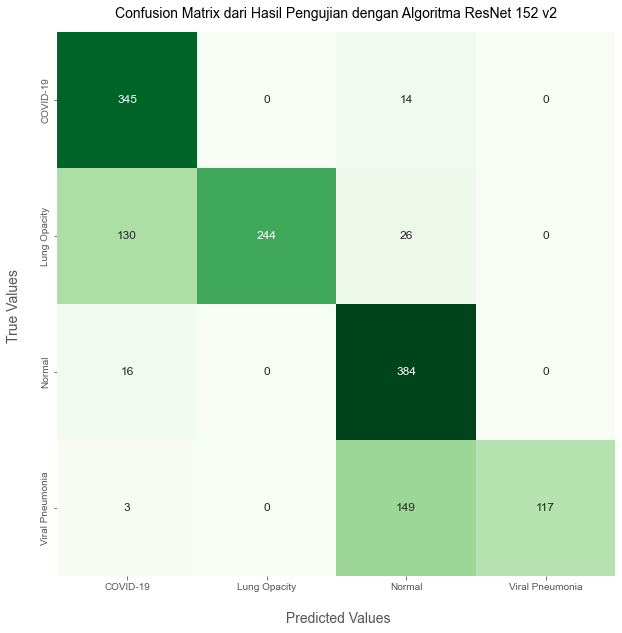

In [48]:
"""
Menampilkan nilai atas hasil klasifikasi yang berhasil
diprediksi berdasarkan label gambar dengan data uji (data testing)
"""

labels = ["COVID-19", "Lung Opacity", "Normal", "Viral Pneumonia"]
cm = confusion_matrix(testing_generator.classes, predictions)

fig = plt.figure(figsize = (10, 10))
ax1 = fig.add_subplot(1, 1, 1)

sns.set(font_scale=1.4) # for label size
sns.heatmap(cm, annot=True, annot_kws={"size": 12}, cbar = False, cmap="Greens", fmt='g');
plt.title("Confusion Matrix dari Hasil Pengujian dengan Algoritma ResNet 152 v2", fontsize=14, pad=14)
ax1.set_ylabel("True Values \n", fontsize=14)
ax1.set_xlabel("\n Predicted Values", fontsize=14)

ax1.xaxis.set_ticklabels(labels); ax1.yaxis.set_ticklabels(labels)

plt.savefig("Graph/Final Graphs/ResNet 152 v2 Graphs/Confusion Matrix - ResNet 152 v2.png")
plt.show()

### 4.3. Membuat Grafik Loss, Val_Loss, Accuracy, dan Val_Accuracy dari Hasil Epochs ResNet 152 v2

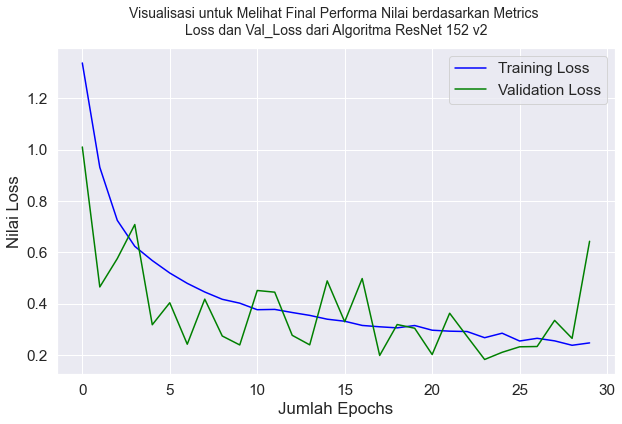

In [49]:
"""
Membuat grafik untuk membandingkan nilai dari loss dan validation loss
dari hasil dari proses training dan testing menggunakan algoritma ResNet 152 v2
"""
plt.figure(figsize=(10, 6))

plt.plot(historyv2.history["loss"], color="blue", label="Training Loss")
plt.plot(historyv2.history["val_loss"], color="green", label="Validation Loss")
plt.title("Visualisasi untuk Melihat Final Performa Nilai berdasarkan Metrics \n"
          "Loss dan Val_Loss dari Algoritma ResNet 152 v2", fontsize=14, pad=14)
plt.xlabel("Jumlah Epochs")
plt.ylabel("Nilai Loss")
plt.legend()
plt.savefig("Graph/Final Graphs/ResNet 152 v2 Graphs/Grafik Loss dan Validation Loss - ResNet 152 v2.png")
plt.show()

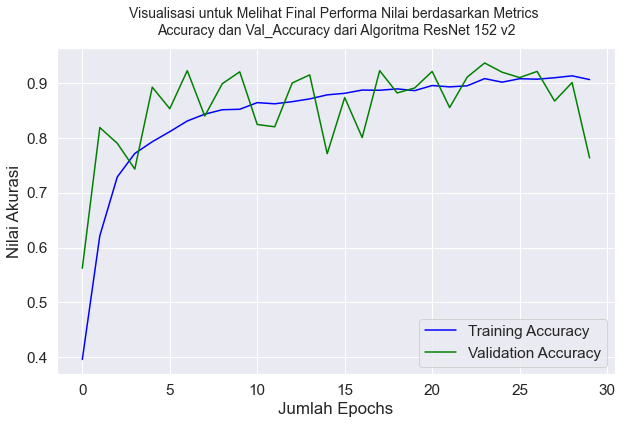

In [50]:
"""
Membuat grafik untuk membandingkan nilai dari akurasi dan validation akurasi
dari hasil dari proses training dan testing menggunakan algoritma ResNet 152 v2
"""
plt.figure(figsize=(10, 6))

plt.plot(historyv2.history["accuracy"], color="blue", label="Training Accuracy")
plt.plot(historyv2.history["val_accuracy"], color="green", label="Validation Accuracy")
plt.title("Visualisasi untuk Melihat Final Performa Nilai berdasarkan Metrics \n"
          "Accuracy dan Val_Accuracy dari Algoritma ResNet 152 v2", fontsize=14, pad=14)
plt.xlabel("Jumlah Epochs")
plt.ylabel("Nilai Akurasi")
plt.legend()
plt.savefig("Graph/Final Graphs/ResNet 152 v2 Graphs/Grafik Accuracy dan Validation Accuracy dari ResNet 152 v2.png")
plt.show()

### 4.4. Membuat Prediksi dengan Data dari Masing-Masing Keempat Kategori/Label Gambar

Di dalam tahap membuat prediksi dari hasil pemodelan deep learning dengan ResNet 152 v2 dengan menggunakan data gambar x-ray paru-paru dari keempat kelas/kategori diantaranya covid-19, lung opacity, normal, dan pneumonia maka didapatkan kesimpulan bahwa model ini sangat cocok digunakan untuk memprediksi berdasarkan klasifikasi dari keempat kelas gambar (image classification) atau juga untuk pengenalan gambar (image recognition). Untuk memastikan kembali apakah hasil pengenalan gambar telah sesuai/belum maka saya akan membuat proses menggunakan codingan dimana gambar dapat dikenali dan dicocokkan dari hasil pelatihan model ResNet 152 v2 yang sebelumnya telah dilakukan menggunakan data training berdasarkan class_image_test yang sebelumnya telah dibuat setelah tahap data augmentation.

Keempat kelas gambar masing-masing akan memiliki 3 bagian untuk memprediksi gambar. Jadi gambar paru-paru dengan kategori covid-19 memiliki 3 prediksi, gambar paru-paru pneumonia akan memiliki 3 prediksi juga, dst.

In [51]:
# Memanggil semua data gambar dengan keempat kategori yang berbeda yang ada di dalam folder COVID-19_Radiography_Dataset_PreProcessed
covid19_images_data = "COVID-19_Radiography_Dataset_PreProcessed/COVID"
lung_opacity_images_data = "COVID-19_Radiography_Dataset_PreProcessed/Lung_Opacity"
normal_images_data = "COVID-19_Radiography_Dataset_PreProcessed/Normal"
pneumonia_images_data = "COVID-19_Radiography_Dataset_PreProcessed/Viral Pneumonia"

In [52]:
from glob import glob

"""
Memanggil semua gambar dengan seluruh eksistensi gambar (.png/.jpg/.jpeg) yang ada
di dalam keempat DataFrame yang menampung data-data gambar berdasarkan kategorinya
"""
# Data gambar paru-paru manusia yang terkena virus covid-19
covid19_data = glob(covid19_images_data + "/*")

# Data gambar paru-paru dengan kategori penyakit yaitu lung opacity
lung_opacity_data = glob(lung_opacity_images_data + "/*")

# Data gambar dengan kategori paru-paru normal
normal_data = glob(normal_images_data + "/*")

# Data gambar dengan penyakit paru-paru denga kategori pneumonia
pneumonia_data = glob(pneumonia_images_data + "/*")

In [53]:
class_images_test = class_list_test
print(class_images_test)

['COVID', 'Lung_Opacity', 'Normal', 'Viral Pneumonia']


#### 4.4.1. Data Gambar dari Kategori Covid-19

##### 4.4.1.1. Gambar dari Kategori Paru-Paru Covid-19 dengan indeks Data Gambar ke-305

In [54]:
"""
Memanggil salah satu gambar paru-paru dari kategori covid-19 untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_covid19 = cv2.imread(str(covid19_data[305])) # Membaca gambar covid-19 yang memiliki indeks ke-305
image_shape = cv2.resize(image_prediction1_covid19, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [55]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

1/1 [==============================] - 6s 6s/step
[[9.9977118e-01 1.3107935e-04 9.7328833e-05 3.4032075e-07]]


In [56]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_covid19_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_covid19_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah COVID


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "covid19_data" dengan indeks gambar ke-305 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder COVID.

##### 4.4.1.2. Gambar dari Kategori Paru-Paru Covid-19 dengan indeks Data Gambar ke-9

In [57]:
"""
Memanggil salah satu gambar paru-paru dari kategori covid-19 untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_covid19 = cv2.imread(str(covid19_data[9])) # Membaca gambar covid-19 yang memiliki indeks ke-9
image_shape = cv2.resize(image_prediction2_covid19, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [58]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 153ms/step
[[9.9949539e-01 2.7637617e-04 2.2510315e-04 3.1424474e-06]]


In [59]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_covid19_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_covid19_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah COVID


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "covid19_data" dengan indeks gambar ke-9 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder COVID.

##### 4.4.1.3. Gambar dari Kategori Paru-Paru Covid-19 dengan indeks Data Gambar ke-1.325

In [60]:
"""
Memanggil salah satu gambar paru-paru dari kategori covid-19 untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_covid19 = cv2.imread(str(covid19_data[1325])) # Membaca gambar covid-19 yang memiliki indeks ke-1325
image_shape = cv2.resize(image_prediction3_covid19, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [61]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 160ms/step
[[9.9959713e-01 2.9951913e-04 9.7215423e-05 6.1132673e-06]]


In [62]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_covid19_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_covid19_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah COVID


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "covid19_data" dengan indeks gambar ke-1325 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder COVID.

#### 4.4.2. Data Gambar dari Kategori Lung Opacity

##### 4.4.2.1. Gambar dari Kategori Paru-Paru Lung Opacity dengan indeks Data Gambar ke-1.165

In [63]:
"""
Memanggil salah satu gambar paru-paru dari kategori lung opacity untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_lung_opacity = cv2.imread(str(lung_opacity_data[1165])) # Membaca gambar lung opacity yang memiliki indeks ke-1165
image_shape = cv2.resize(image_prediction1_lung_opacity, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [64]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

1/1 [==============================] - 0s 187ms/step
[[0.37258688 0.04606772 0.5807408  0.0006046 ]]


In [65]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_lung_opacity_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_lung_opacity_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Normal


Berdasarkan hasil prediksi dapat diketahui bahwa hasil diatas merupakan HASIL YANG TIDAK TEPAT dalam memprediksi gambar Lung_Opacity dengan indeks gambar ke-1.165. Nilai input/label input-nya adalah data gambar dari sub-folder Lung_Opacity tetapi hasil dari prediksi menyatakan bahwa gambar dengan indeks ke-1.165 merupakan gambar paru-paru Normal yang seharusnya merupakan gambar dari sub-folder Lung_Opacity.

##### 4.4.2.2. Gambar dari Kategori Paru-Paru Lung Opacity dengan indeks Data Gambar ke-382

In [66]:
"""
Memanggil salah satu gambar paru-paru dari kategori lung opacity untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_lung_opacity = cv2.imread(str(lung_opacity_data[382])) # Membaca gambar lung opacity yang memiliki indeks ke-382
image_shape = cv2.resize(image_prediction2_lung_opacity, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [67]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 161ms/step
[[0.66690636 0.2702175  0.05286603 0.01001009]]


In [68]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_lung_opacity_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_lung_opacity_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah COVID


Berdasarkan hasil prediksi dapat diketahui bahwa hasil diatas merupakan HASIL YANG TIDAK TEPAT dalam memprediksi gambar Lung_Opacity dengan indeks gambar ke-382. Nilai input/label input-nya adalah data gambar dari sub-folder Lung_Opacity tetapi hasil dari prediksi menyatakan bahwa gambar dengan indeks ke-382 merupakan gambar paru-paru COVID yang seharusnya merupakan gambar dari sub-folder Lung_Opacity.

##### 4.4.2.3. Gambar dari Kategori Paru-Paru Lung Opacity dengan indeks Data Gambar ke-90

In [69]:
"""
Memanggil salah satu gambar paru-paru dari kategori lung opacity untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_lung_opacity = cv2.imread(str(lung_opacity_data[90])) # Membaca gambar lung opacity yang memiliki indeks ke-90
image_shape = cv2.resize(image_prediction3_lung_opacity, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [70]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 155ms/step
[[0.08557339 0.9015472  0.01146575 0.00141374]]


In [71]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_lung_opacity_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_lung_opacity_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Lung_Opacity


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "lung_opacity_data" dengan indeks gambar ke-90 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Lung_Opacity.

#### 4.4.3. Data Gambar dari Kategori Normal

##### 4.4.3.1. Gambar dari Kategori Paru-Paru Normal dengan indeks Data Gambar ke-137

In [72]:
"""
Memanggil salah satu gambar paru-paru dari kategori normal untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_normal = cv2.imread(str(normal_data[137])) # Membaca gambar normal yang memiliki indeks ke-137
image_shape = cv2.resize(image_prediction1_normal, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [73]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

1/1 [==============================] - 0s 145ms/step
[[1.4608855e-04 9.7758450e-05 9.9878508e-01 9.7106904e-04]]


In [74]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_normal_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_normal_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Normal


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_data" dengan indeks gambar ke-137 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Normal.

##### 4.4.3.2. Gambar dari Kategori Paru-Paru Normal dengan indeks Data Gambar ke-1560

In [75]:
"""
Memanggil salah satu gambar paru-paru dari kategori normal untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_normal = cv2.imread(str(normal_data[1560])) # Membaca gambar normal yang memiliki indeks ke-1560
image_shape = cv2.resize(image_prediction2_normal, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [76]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 151ms/step
[[1.4421072e-05 6.1124538e-06 9.9819535e-01 1.7842072e-03]]


In [77]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_normal_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_normal_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Normal


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_data" dengan indeks gambar ke-1560 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Normal.

##### 4.4.3.3. Gambar dari Kategori Paru-Paru Normal dengan indeks Data Gambar ke-632

In [78]:
"""
Memanggil salah satu gambar paru-paru dari kategori normal untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_normal = cv2.imread(str(normal_data[632])) # Membaca gambar normal yang memiliki indeks ke-632
image_shape = cv2.resize(image_prediction3_normal, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [79]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 149ms/step
[[2.0867493e-04 1.5939209e-03 9.9813300e-01 6.4354143e-05]]


In [80]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_normal_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_normal_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Normal


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "normal_data" dengan indeks gambar ke-632 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Normal.

#### 4.4.4. Data Gambar dari Kategori Viral Pneumonia

##### 4.4.4.1. Gambar dari Kategori Paru-Paru Pneumonia dengan indeks Data Gambar ke-1.002

In [81]:
"""
Memanggil salah satu gambar paru-paru dari kategori pneumonia untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction1_pneumonia = cv2.imread(str(pneumonia_data[1002])) # Membaca gambar pneumonia yang memiliki indeks ke-1002
image_shape = cv2.resize(image_prediction1_pneumonia, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction1 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction1.shape)

(1, 100, 100, 3)


In [82]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction1 = ResNet_algorithm_152v2.predict(image_prediction1)
print(prediction1)

1/1 [==============================] - 0s 149ms/step
[[0.01684287 0.00271576 0.03755973 0.9428816 ]]


In [83]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_pneumonia_image1 = class_images_test[np.argmax(prediction1)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_pneumonia_image1)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Viral Pneumonia


Berdasarkan hasil prediksi dapat diketahui secara tepat dan akurat bahwa gambar yang berasal dari variabel "pneumonia_data" dengan indeks gambar ke-1002 dapat diklasifikasikan secara tepat oleh model ResNet 152 v2 bahwa kelas/kategori gambar berasal dari kategori sub-folder Viral Pneumonia.

##### 4.4.4.2. Gambar dari Kategori Paru-Paru Pneumonia dengan indeks Data Gambar ke-1.200

In [84]:
"""
Memanggil salah satu gambar paru-paru dari kategori pneumonia untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction2_pneumonia = cv2.imread(str(pneumonia_data[1200])) # Membaca gambar pneumonia yang memiliki indeks ke-1200
image_shape = cv2.resize(image_prediction2_pneumonia, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction2 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction2.shape)

(1, 100, 100, 3)


In [85]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction2 = ResNet_algorithm_152v2.predict(image_prediction2)
print(prediction2)

1/1 [==============================] - 0s 143ms/step
[[0.00832662 0.00248048 0.69645697 0.2927359 ]]


In [86]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_pneumonia_image2 = class_images_test[np.argmax(prediction2)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_pneumonia_image2)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Normal


Berdasarkan hasil prediksi dapat diketahui bahwa hasil diatas merupakan HASIL YANG TIDAK TEPAT dalam memprediksi gambar Viral Pneumonia dengan indeks gambar ke-1.200. Nilai input/label input-nya adalah data gambar dari sub-folder Viral Pneumonia tetapi hasil dari prediksi menyatakan bahwa gambar dengan indeks ke-1.200 merupakan gambar dari label Normal yang seharusnya gambar tersebut berasal dari label Viral Pneumonia.

##### 4.4.4.3. Gambar dari Kategori Paru-Paru Pneumonia dengan indeks Data Gambar ke-921

In [87]:
"""
Memanggil salah satu gambar paru-paru dari kategori pneumonia untuk dilakukan
tahap prediksi apakah sudah tepat dalam memprediksi kategori/belum
"""
image_prediction3_pneumonia = cv2.imread(str(pneumonia_data[921])) # Membaca gambar pneumonia yang memiliki indeks ke-921
image_shape = cv2.resize(image_prediction3_pneumonia, (100, 100)) # Mengatur dimensi gambar yang berupa lebar (width) & tinggi (height) gambar
image_prediction3 = np.expand_dims(image_shape, axis=0) # Memperluas dimensi dari gambar yang akan diprediksi menjadi 4 dimensi

print(image_prediction3.shape)

(1, 100, 100, 3)


In [88]:
"""
Memanggil model ResNet 152 v2 yang telah dilatih dengan data training
serta diujikan kepada data testing dan buat prediksi gambarnya
"""
prediction3 = ResNet_algorithm_152v2.predict(image_prediction3)
print(prediction3)

1/1 [==============================] - 0s 166ms/step
[[0.00354247 0.00167379 0.86407346 0.13071038]]


In [89]:
# Melihat hasil prediksi gambar yang telah diinisialisasikan
output_category_pneumonia_image3 = class_images_test[np.argmax(prediction3)]
print("Hasil Prediksi Kelas/Kategori Gambar ini adalah", output_category_pneumonia_image3)

Hasil Prediksi Kelas/Kategori Gambar ini adalah Normal


Berdasarkan hasil prediksi dapat diketahui bahwa hasil diatas merupakan HASIL YANG TIDAK TEPAT dalam memprediksi gambar Viral Pneumonia dengan indeks gambar ke-921. Nilai input/label input-nya adalah data gambar dari sub-folder Viral Pneumonia tetapi hasil dari prediksi menyatakan bahwa gambar dengan indeks ke-921 merupakan gambar paru-paru Normal yang seharusnya merupakan gambar dari sub-folder Viral Pneumonia.